## The graphs I talked about are in the artist_tracks.ipynb notebook. This is where I was testing out cleaning methods on the data and getting a better sense of what even needed to be cleaned.

In [1]:
%matplotlib inline

In [2]:
# Import dependencies
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy.stats as st
from scipy.stats import linregress
import os
from datetime import datetime as dt 

In [3]:
# Load in file -- 586672 tracks
file_path = os.path.join(os.getcwd(),'Resources', 'tracks.csv')
tracks_df = pd.read_csv(file_path)

In [4]:
# Clean and format data 
clean_df = tracks_df[['id', 'name', 'popularity', 'duration_ms', 'explicit', 'artists', 'release_date', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo']]

In [5]:
# dropping rows with missing values
clean_df = clean_df.dropna(how = 'any') # 586601 tracks
clean_df['year'] = pd.DatetimeIndex(clean_df['release_date']).year  # adds new column for year & converts release date

In [6]:
# removing releases from before 1950 because pop music as a genre is considered to start in the 1950s
# 547963 remain
clean_reduced_df = clean_df.loc[clean_df['year'] > 1949]

In [7]:
## Looking at tracks, unique titles, artists, & trying to determine possible duplicates
total_tracks = len(clean_reduced_df)
unique_songs = clean_reduced_df['name'].nunique()
unique_artists = clean_reduced_df['artists'].nunique()
pos_dupes = total_tracks - unique_songs
print(f"Number of lines in current set = {total_tracks} \n The number of unique song titles = {unique_songs} \n The number of artists = {unique_artists}")
print(f"\n Possible duplicates = {pos_dupes}, which is {round(pos_dupes/total_tracks*100,2)}%. Because different artists have songs with the same titles, the actual percentage of duplicates is less than this.")

Number of lines in current set = 547963 
 The number of unique song titles = 417848 
 The number of artists = 108555

 Possible duplicates = 130115, which is 23.75%. Because different artists have songs with the same titles, the actual percentage of duplicates is less than this.


In [8]:
# smaller dataframe that might help figure out loops 
# 2962 rows
# different artists & different song titles -- but should have duplicates of both
contains_one_df = clean_df.loc[clean_df['name'].str.contains('One')].reset_index()

In [9]:
# converting release_date to year & adding column for year
contains_one_df['year'] = pd.DatetimeIndex(contains_one_df['release_date']).year

In [10]:
# removing rows older than 1950 
# 2803 rows, 18 cols
one_reduced_df = contains_one_df.loc[contains_one_df['year'] > 1949]

In [11]:
# smaller dataframe that might help figure out loops 
# 290 rows; 203 songs
# one artist & different song titles -- but few duplicates of song titles
u2_df = clean_df.loc[clean_df['artists'] == "['U2']"].reset_index()
u2_songs = u2_df['name'].nunique()  #203

In [17]:
# smaller dataframe for testing loops
# 77 tracks, 34 songs
# one artist & multiple duplicates that look like exact same track
gaga_df = clean_df.loc[clean_df['artists'] == "['Lady Gaga']"]
gaga_songs = gaga_df['name'].nunique()
gaga_df     

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.1210,0.787,118.999,2008
81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.1210,0.787,118.999,2008
81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.0940,0.397,114.906,2008
81417,7Hqig8kp32q2Ire3ECQvWM,Paparazzi,69,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.0940,0.397,114.906,2008
81543,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.00569,0.000002,0.3170,0.844,105.024,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558981,4q57oGT90FfPHf7vWp32Ho,Judas,38,249067,0,['Lady Gaga'],2011-01-01,0.664,0.934,-3.848,0.0697,0.00108,0.000028,0.2700,0.530,130.982,2011
559227,69jnWw97sX1dYK2grPhyF9,You And I,31,307360,0,['Lady Gaga'],2011-01-01,0.521,0.701,-5.238,0.0458,0.08920,0.000000,0.0876,0.518,127.087,2011
559768,1EntfuxWPYjI8ONzkfNb0W,Applause,40,212333,0,['Lady Gaga'],2013-11-11,0.669,0.780,-4.287,0.0530,0.02650,0.000002,0.1430,0.738,139.945,2013
561178,3jArQ9tPKWxKnn18iXS3TF,Million Reasons,41,205280,0,['Lady Gaga'],2016-10-21,0.666,0.423,-8.012,0.0430,0.49400,0.000000,0.1060,0.154,129.890,2016


In [18]:
# smaller data frame for testing loops
# 8 rows
# just 1 song -- but looks like several different versions based on acoustic values
poker_face_df = gaga_df.loc[gaga_df['name'].str.contains('Poker Face')].reset_index()
poker_face_df

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
0,81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.1210,0.787,118.999,2008
1,81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.1210,0.787,118.999,2008
2,110065,4liFTpYparE2zEUp2GfG64,Poker Face,36,238907,0,['Lady Gaga'],2020-10-23,0.851,0.818,-4.637,0.0789,0.112,0.000003,0.0945,0.808,119.006,2020
3,130728,7zACUQbWQxzT4aER7ityBV,Poker Face,57,237200,0,['Lady Gaga'],2009-11-05,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.1210,0.787,118.999,2009
4,200963,4wB4cPK52RCQviHm4SC2wa,Poker Face,9,238907,0,['Lady Gaga'],2020-10-23,0.851,0.818,-4.637,0.0789,0.112,0.000003,0.0945,0.808,119.006,2020
5,387594,3cJTPvEe33hGNJguNPAoBC,Poker Face,46,237533,0,['Lady Gaga'],2008-09-26,0.849,0.824,-4.610,0.0788,0.128,0.000003,0.0867,0.785,119.001,2008
6,444082,0gVpWodvUHcvcgVjK26Jga,Poker Face,3,238320,0,['Lady Gaga'],2015-12-11,0.850,0.784,-5.668,0.0785,0.134,0.000003,0.0997,0.779,119.000,2015
7,583175,70vvnTUamBXOc0vRk7BBDu,Poker Face,50,237200,0,['Lady Gaga'],2009-11-18,0.851,0.806,-4.618,0.0788,0.120,0.000001,0.1220,0.775,119.002,2009


### List of dataframes
* clean_df = 586601 lines -- what ultimately needs to be cleaned
* clean_reduced_df = 547963 lines -- release dates were converted to years & tracks from pre-1950 have been removed
* contains_one_df = 2962 lines -- should have duplicate artists & duplicate tracks in varying combos
* u2_df = 290 lines -- just U2, has duplicate tracks but some are definitely different versions
* gaga_df = 77 lines -- just Lady Gaga, has duplicate tracks
* poker_face_df = 8 lines -- all versions of "Poker Face"--4 of which look identical except popularity

### Cleaning for artist x number of tracks popularity
1. remove release dates pre-1950 bc contemporary pop music is considered to have started in mid-1950s, so removing older tracks seems reasonable
2. 

In [14]:
clean_reduced_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
23549,5RcvlmVx2xtFcp2Ta5pw7X,Someone To Watch Over Me,57,196667,0,['Ella Fitzgerald'],1950-09-11,0.354,0.0851,-13.738,0.0345,0.990,0.000004,0.1230,0.1970,97.684,1950
23550,5DIVWgTeJ2fPIxaY9e7ZKn,I've Got A Crush On You,56,196440,0,['Ella Fitzgerald'],1950-09-11,0.455,0.1060,-14.086,0.0422,0.986,0.000000,0.1220,0.2580,66.807,1950
23551,50AnCqAVXt8qR1RJtGudUU,Camino de Guanajuato,55,184533,0,['José Alfredo Jimenez'],1950,0.572,0.4720,-7.359,0.0314,0.834,0.000002,0.1660,0.7830,94.826,1950
23552,0VX8ptOQhUt1SIOHYLZGNN,Stardust,48,146347,0,['Hoagy Carmichael'],1950-01-01,0.658,0.0542,-19.427,0.0596,0.960,0.106000,0.1060,0.3450,90.138,1950
23553,2aCmTIqpOduPWwsRQ6t4iD,Ella,46,166173,0,['José Alfredo Jimenez'],1950,0.665,0.4850,-6.586,0.0456,0.832,0.000106,0.4260,0.9380,99.449,1950
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
586667,5rgu12WBIHQtvej2MdHSH0,云与海,50,258267,0,['阿YueYue'],2020-09-26,0.560,0.5180,-7.471,0.0292,0.785,0.000000,0.0648,0.2110,131.896,2020
586668,0NuWgxEp51CutD2pJoF4OM,blind,72,153293,0,['ROLE MODEL'],2020-10-21,0.765,0.6630,-5.223,0.0652,0.141,0.000297,0.0924,0.6860,150.091,2020
586669,27Y1N4Q4U3EfDU5Ubw8ws2,What They'll Say About Us,70,187601,0,['FINNEAS'],2020-09-02,0.535,0.3140,-12.823,0.0408,0.895,0.000150,0.0874,0.0663,145.095,2020
586670,45XJsGpFTyzbzeWK8VzR8S,A Day At A Time,58,142003,0,"['Gentle Bones', 'Clara Benin']",2021-03-05,0.696,0.6150,-6.212,0.0345,0.206,0.000003,0.3050,0.4380,90.029,2021


In [15]:
rank_test_df = clean_reduced_df
rank_test_df['year_rank'] = rank_test_df.groupby('artists')['year'].rank(method='dense')
rank_test_df.head(10)

<ipython-input-15-bb5b89c28960>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rank_test_df['year_rank'] = rank_test_df.groupby('artists')['year'].rank(method='dense')


,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year,year_rank
23549,5RcvlmVx2xtFcp2Ta5pw7X,Someone To Watch Over Me,57,196667,0,['Ella Fitzgerald'],1950-09-11,0.354,0.0851,-13.738,0.0345,0.990,0.000004,0.1230,0.197,97.684,1950,1.0
23550,5DIVWgTeJ2fPIxaY9e7ZKn,I've Got A Crush On You,56,196440,0,['Ella Fitzgerald'],1950-09-11,0.455,0.1060,-14.086,0.0422,0.986,0.000000,0.1220,0.258,66.807,1950,1.0
23551,50AnCqAVXt8qR1RJtGudUU,Camino de Guanajuato,55,184533,0,['José Alfredo Jimenez'],1950,0.572,0.4720,-7.359,0.0314,0.834,0.000002,0.1660,0.783,94.826,1950,1.0
23552,0VX8ptOQhUt1SIOHYLZGNN,Stardust,48,146347,0,['Hoagy Carmichael'],1950-01-01,0.658,0.0542,-19.427,0.0596,0.960,0.106000,0.1060,0.345,90.138,1950,1.0
23553,2aCmTIqpOduPWwsRQ6t4iD,Ella,46,166173,0,['José Alfredo Jimenez'],1950,0.665,0.4850,-6.586,0.0456,0.832,0.000106,0.4260,0.938,99.449,1950,1.0
23554,0Sk1dGnZC0LK1y5sAkhKGa,Paloma Querida,46,155667,0,['José Alfredo Jimenez'],1950,0.417,0.5250,-7.320,0.0885,0.768,0.000000,0.3820,0.620,173.475,1950,1.0
23555,1oG967FC3aVAMgEcZMyjlY,OPM Medley: When I Met You,45,557987,0,['Freestyle'],1950-01-01,0.402,0.4860,-10.941,0.0487,0.434,0.000000,0.9790,0.298,86.923,1950,1.0
23556,3jvNwwHkWjELV3QALVz47D,If You've Got the Money I've Got the Time,44,179307,0,['Lefty Frizzell'],1950,0.545,0.3920,-10.091,0.0481,0.830,0.000094,0.0903,0.951,208.426,1950,1.0
23557,0PdSJDj4obCyXX7hlgyuEd,Gandagana,42,496907,0,['Georgian People'],1950-07-23,0.468,0.7110,-7.912,0.0703,0.407,0.000000,0.1780,0.670,111.306,1950,1.0
23558,43iaHz5dLnKRovc3DLQApU,El Mudo,42,139627,0,['La Sonora Santanera'],1950,0.581,0.4000,-16.394,0.0480,0.880,0.000126,0.0676,0.982,93.130,1950,1.0


In [ ]:
summary4_df = rank_test_df.groupby(['artists','year_rank'])['popularity'].agg(artist_tracks='count', pop_mean='mean', pop_med='median',pop_max='max', pop_min='min', pop_sum='sum', pop_var='var', pop_std='std', pop_sem='sem')
summary4_df

artist_tracks  \
artists                                            year_rank                  
["'In The Heights' Original Broadway Company", ... 1.0                    1   
["'Om' Alec Khaoli & Umoja"]                       1.0                    1   
["'T Hof Van Commerce", 'TLP']                     1.0                    1   
["'T Hof Van Commerce"]                            1.0                    4   
                                                   2.0                    1   
...                                                                     ...   
['조정현']                                            1.0                    1   
['지선']                                             1.0                    1   
                                                   2.0                    1   
['지수']                                             1.0                    1   
['최진희']                                            1.0                    1   

                                                              pop_mean  \
artists                                            year_rank             
["'In The Heights' Original Broadway Company", ... 1.0           55.00   
["'Om' Alec Khaoli & Umoja"]                       1.0           38.00   
["'T Hof Van Commerce", 'TLP']                     1.0           29.00   
["'T Hof Van Commerce"]                            1.0           21.25   
                                                   2.0           35.00   
...                                                                ...   
['조정현']                                            1.0           32.00   
['지선']                                             1.0           39.00   
                                                   2.0           44.00   
['지수']                                             1.0           28.00   
['최진희']                                            1.0           25.00   

                                                              pop_med  \
artists                                            year_rank            
["'In The Heights' Original Broadway Company", ... 1.0           55.0   
["'Om' Alec Khaoli & Umoja"]                       1.0           38.0   
["'T Hof Van Commerce", 'TLP']                     1.0           29.0   
["'T Hof Van Commerce"]                            1.0           19.5   
                                                   2.0           35.0   
...                                                               ...   
['조정현']                                            1.0           32.0   
['지선']                                             1.0           39.0   
                                                   2.0           44.0   
['지수']                                             1.0           28.0   
['최진희']                                            1.0           25.0   

                                                              pop_max  \
artists                                            year_rank            
["'In The Heights' Original Broadway Company", ... 1.0             55   
["'Om' Alec Khaoli & Umoja"]                       1.0             38   
["'T Hof Van Commerce", 'TLP']                     1.0             29   
["'T Hof Van Commerce"]                            1.0             30   
                                                   2.0             35   
...                                                               ...   
['조정현']                                            1.0             32   
['지선']                                             1.0             39   
                                                   2.0             44   
['지수']                                             1.0             28   
['최진희']                                            1.0             25   

                                                              pop_min  \
artists                                            year_rank            
["'In The Heights' Origin

In [ ]:
summary3_df = clean_reduced_df.groupby('artists')['popularity'].agg(artist_tracks='count', pop_mean='mean', pop_med='median',pop_max='max', pop_min='min', pop_sum='sum', pop_var='var', pop_std='std', pop_sem='sem')
summary3_df

,artist_tracks,pop_mean,pop_med,pop_max,pop_min,pop_sum,pop_var,pop_std,pop_sem
artists,,,,,,,,,
"[""'In The Heights' Original Broadway Company"", 'Mandy Gonzalez']",1,55.000000,55.0,55,55,55,NaN,NaN,NaN
"[""'Om' Alec Khaoli & Umoja""]",1,38.000000,38.0,38,38,38,NaN,NaN,NaN
"[""'T Hof Van Commerce"", 'TLP']",1,29.000000,29.0,29,29,29,NaN,NaN,NaN
"[""'T Hof Van Commerce""]",6,25.166667,25.5,35,16,151,61.366667,7.833688,3.198090
"[""'Til Tuesday""]",8,35.875000,32.0,58,23,287,128.696429,11.344445,4.010867
...,...,...,...,...,...,...,...,...,...
['장정우'],2,31.500000,31.5,32,31,63,0.500000,0.707107,0.500000
['조정현'],1,32.000000,32.0,32,32,32,NaN,NaN,NaN
['지선'],2,41.500000,41.5,44,39,83,12.500000,3.535534,2.500000


In [ ]:
sum3_reduced_df = summary3_df.loc[summary3_df['artist_tracks'] < 1000, :]
sum3_reduced_df

,artist_tracks,pop_mean,pop_med,pop_max,pop_min,pop_sum,pop_var,pop_std,pop_sem
artists,,,,,,,,,
"[""'In The Heights' Original Broadway Company"", 'Mandy Gonzalez']",1,55.000000,55.0,55,55,55,NaN,NaN,NaN
"[""'Om' Alec Khaoli & Umoja""]",1,38.000000,38.0,38,38,38,NaN,NaN,NaN
"[""'T Hof Van Commerce"", 'TLP']",1,29.000000,29.0,29,29,29,NaN,NaN,NaN
"[""'T Hof Van Commerce""]",6,25.166667,25.5,35,16,151,61.366667,7.833688,3.198090
"[""'Til Tuesday""]",8,35.875000,32.0,58,23,287,128.696429,11.344445,4.010867
...,...,...,...,...,...,...,...,...,...
['장정우'],2,31.500000,31.5,32,31,63,0.500000,0.707107,0.500000
['조정현'],1,32.000000,32.0,32,32,32,NaN,NaN,NaN
['지선'],2,41.500000,41.5,44,39,83,12.500000,3.535534,2.500000


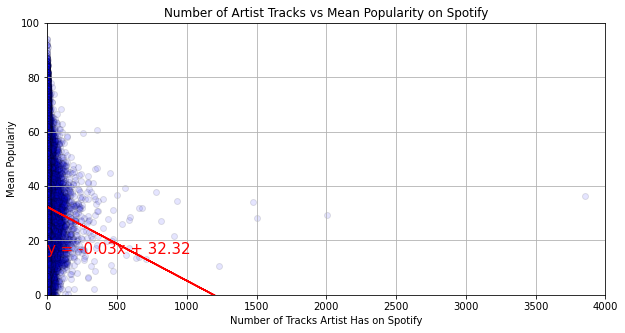

The r-squared is: 0.0010710740160094399
The correlation between both factors is -0.03 & p-value is 4.024236885591702e-27


In [ ]:
## Number of Artist Tracks vs Mean Popularity on Spotify
plt.figure(figsize=(10,5))
x_values = summary3_df['artist_tracks']
y_values = summary3_df['pop_mean']
(slope, intercept, rvalue, pvalue, stderr) = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.scatter(x_values,y_values, color='blue', edgecolor='black', alpha=0.1)
plt.plot(x_values,regress_values,"r-")
plt.annotate(line_eq,(.40,15),fontsize=15,color="red")
#plt.xticks(0, 100)
plt.xlim(0, 4000)
plt.ylim(0,100)
plt.xlabel('Number of Tracks Artist Has on Spotify')
plt.ylabel('Mean Populariy')
plt.title('Number of Artist Tracks vs Mean Popularity on Spotify')
plt.grid()
#plt.savefig("output_data/Fig5.png")
plt.show()
print(f"The r-squared is: {rvalue**2}")
instrumental_rsquared = (rvalue**2)
correlation = st.pearsonr(x_values,y_values)
print(f"The correlation between both factors is {round(correlation[0],2)} & p-value is {pvalue}")

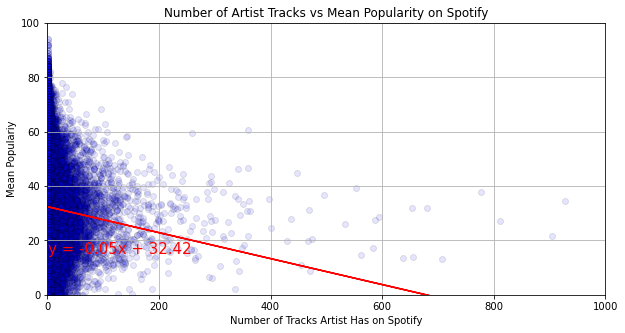

The r-squared is: 0.0018616193262364416
The correlation between both factors is -0.04 & p-value is 6.7008228370825895e-46


In [ ]:
## Number of Artist Tracks vs Mean Popularity on Spotify
plt.figure(figsize=(10,5))
x_values = sum3_reduced_df['artist_tracks']
y_values = sum3_reduced_df['pop_mean']
(slope, intercept, rvalue, pvalue, stderr) = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.scatter(x_values,y_values, color='blue', edgecolor='black', alpha=0.1)
plt.plot(x_values,regress_values,"r-")
plt.annotate(line_eq,(.40,15),fontsize=15,color="red")
#plt.xticks(0, 100)
plt.xlim(0, 1000)
plt.ylim(0,100)
plt.xlabel('Number of Tracks Artist Has on Spotify')
plt.ylabel('Mean Populariy')
plt.title('Number of Artist Tracks vs Mean Popularity on Spotify')
plt.grid()
#plt.savefig("output_data/Fig5.png")
plt.show()
print(f"The r-squared is: {rvalue**2}")
instrumental_rsquared = (rvalue**2)
correlation = st.pearsonr(x_values,y_values)
print(f"The correlation between both factors is {round(correlation[0],2)} & p-value is {pvalue}")

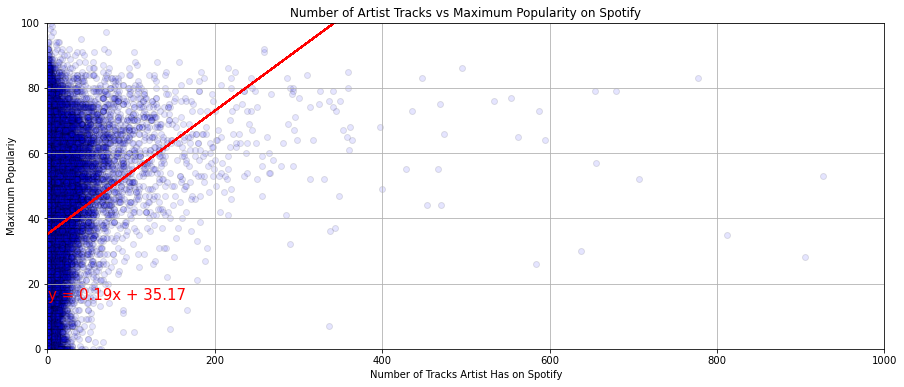

The r-squared is: 0.02580549058424858
The correlation between both factors is 0.16 & p-value is 0.0


In [ ]:
## Number of Artist Tracks vs Max Popularity on Spotify
plt.figure(figsize=(15,6))
x_values = sum3_reduced_df['artist_tracks']
y_values = sum3_reduced_df['pop_max']
(slope, intercept, rvalue, pvalue, stderr) = linregress(x_values, y_values)
regress_values = x_values * slope + intercept
line_eq = "y = " + str(round(slope,2)) + "x + " + str(round(intercept,2))
plt.scatter(x_values,y_values, color='blue', edgecolor='black', alpha=0.1)
plt.plot(x_values,regress_values,"r-")
plt.annotate(line_eq,(.40,15),fontsize=15,color="red")
plt.xlim(0,1000)
plt.ylim(0, 100)
plt.xlabel('Number of Tracks Artist Has on Spotify')
plt.ylabel('Maximum Populariy')
plt.title('Number of Artist Tracks vs Maximum Popularity on Spotify')
plt.grid()
#plt.savefig("output_data/Fig5.png")
plt.show()
print(f"The r-squared is: {rvalue**2}")
instrumental_rsquared = (rvalue**2)
correlation = st.pearsonr(x_values,y_values)
print(f"The correlation between both factors is {round(correlation[0],2)} & p-value is {pvalue}")

In [ ]:
working_df = clean_reduced_df.loc[clean_reduced_df['artists'] == "['Lady Gaga']", :]
working_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.1210,0.787,118.999,2008
81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.1210,0.787,118.999,2008
81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.0940,0.397,114.906,2008
81417,7Hqig8kp32q2Ire3ECQvWM,Paparazzi,69,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.0940,0.397,114.906,2008
81543,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.00569,0.000002,0.3170,0.844,105.024,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558981,4q57oGT90FfPHf7vWp32Ho,Judas,38,249067,0,['Lady Gaga'],2011-01-01,0.664,0.934,-3.848,0.0697,0.00108,0.000028,0.2700,0.530,130.982,2011
559227,69jnWw97sX1dYK2grPhyF9,You And I,31,307360,0,['Lady Gaga'],2011-01-01,0.521,0.701,-5.238,0.0458,0.08920,0.000000,0.0876,0.518,127.087,2011
559768,1EntfuxWPYjI8ONzkfNb0W,Applause,40,212333,0,['Lady Gaga'],2013-11-11,0.669,0.780,-4.287,0.0530,0.02650,0.000002,0.1430,0.738,139.945,2013
561178,3jArQ9tPKWxKnn18iXS3TF,Million Reasons,41,205280,0,['Lady Gaga'],2016-10-21,0.666,0.423,-8.012,0.0430,0.49400,0.000000,0.1060,0.154,129.890,2016


## Building Loop to Remove Duplicates
1. go to each artist  
2. add songs to a checklist
3. for duplicate songs check duration_ms # SKIP THIS -- GOING STRAIGHT FOR DURATION SHOULD CATCH MOST THINGS & REQUIRES LESS BOUNCING
4. if duplicate song has different duration_ms, keep it
5. if duplicate song has SAME duration_ms, compare popularity ratings
6. keep the higher popularity rating


In [ ]:
working_df.duplicated(subset=['name', 'duration_ms', 'artists'])

81271     False
81300      True
81331     False
81417      True
81543     False
          ...  
558981     True
559227     True
559768     True
561178     True
583175     True
Length: 77, dtype: bool

In [ ]:
# taking duration out of the criteria because there are multiples that are within a few ms & the same year
# count of duplicates; when no keep= comes to 32; when keep=False (with duration included) = 49
working_df.duplicated(subset=['name', 'artists'],keep=False).sum()

60

In [ ]:
# Count the number of non-duplicates when no keep= comes to 45; when keep=False (with duration included) = 28
(~working_df.duplicated(subset=['name', 'artists'],keep=False)).sum()

17

In [ ]:
# should be non-dupe, but I can see some of the values that have dupes -- adding keep=False took care of previous issue
gaga_unique_df = working_df.loc[~working_df.duplicated(subset=['name', 'artists'],keep=False), :]
gaga_unique_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
86592,4rYLpaNFzt6pkQnrCvVHUw,G.U.Y.,65,232667,1,['Lady Gaga'],2013-11-11,0.616,0.919,-3.468,0.0401,0.014100,0.000000,0.1170,0.572,110.008,2013
86952,3n3S5cH3IyaOswY2XSUGTS,Venus,62,233720,1,['Lady Gaga'],2013-11-11,0.811,0.895,-4.304,0.0608,0.026700,0.000000,0.1040,0.736,121.010,2013
118191,2WgyOP8Z1D6GQYumCwH4Dk,Monster,58,249280,1,['Lady Gaga'],2009-11-05,0.694,0.801,-4.503,0.0441,0.001240,0.000000,0.4790,0.646,119.969,2009
130837,6Qh10T7u43YciJsJa99R3v,Dance In The Dark,56,288960,1,['Lady Gaga'],2009-11-05,0.639,0.751,-6.357,0.0324,0.000030,0.000049,0.1630,0.130,120.992,2009
174764,0Bjr5EAEa5YxfSHHWzZmds,"Beautiful, Dirty, Rich",53,172413,0,['Lady Gaga'],2008-01-01,0.782,0.906,-5.229,0.1520,0.017000,0.050300,0.2930,0.697,120.064,2008
174984,1NrfEZrNm0Dq8ulfYMxwSc,So Happy I Could Die,54,234867,0,['Lady Gaga'],2009-11-05,0.557,0.772,-5.068,0.0304,0.000318,0.002340,0.1760,0.324,99.967,2009
186419,3WUbVS0J4Ulf0XZR6LNRnh,"Eh, Eh (Nothing Else I Can Say)",51,175360,0,['Lady Gaga'],2008-01-01,0.680,0.876,-3.646,0.0577,0.246000,0.000187,0.0788,0.816,187.785,2008
218439,56ZrTFkANjeAMiS14njg4E,Perfect Illusion,65,182000,0,['Lady Gaga'],2016-10-21,0.613,0.857,-5.492,0.0366,0.001200,0.000000,0.3580,0.664,124.987,2016
244985,1sRByD63uI8ZJAOSPDczXF,Americano,53,246533,0,['Lady Gaga'],2011-05-23,0.608,0.848,-5.086,0.0326,0.000622,0.000004,0.4290,0.338,127.999,2011
245018,7DXGKFjM7GNkJd32oXstGY,ScheiBe,54,225467,0,['Lady Gaga'],2011-05-23,0.739,0.970,-4.885,0.1180,0.004900,0.000001,0.2730,0.519,131.003,2011


In [ ]:
# Extract duplicate rows
gaga_dupes_df = working_df.loc[working_df.duplicated(subset=['name', 'artists'],keep=False), :]
gaga_dupes_df = gaga_dupes_df.sort_values(['name', 'popularity'], ascending=False)
gaga_dupes_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
84730,1ADciGUxOaUbBFd0rpYx7d,You And I,62,307360,0,['Lady Gaga'],2011-05-23,0.521,0.701,-5.238,0.0458,0.089200,0.000000,0.0876,0.518,127.087,2011
303590,6rkAY9rk1NTFB94QxG3LJR,You And I,60,307347,0,['Lady Gaga'],2011-01-01,0.518,0.709,-5.234,0.0476,0.075000,0.000000,0.0935,0.514,127.083,2011
559227,69jnWw97sX1dYK2grPhyF9,You And I,31,307360,0,['Lady Gaga'],2011-01-01,0.521,0.701,-5.238,0.0458,0.089200,0.000000,0.0876,0.518,127.087,2011
84326,57F80059mWaWFvWG3tBTbO,The Edge Of Glory,68,320547,0,['Lady Gaga'],2011-05-23,0.583,0.768,-6.477,0.0410,0.000323,0.016200,0.1090,0.357,127.952,2011
303555,0JNdS1n0ifOP25XvhwAMgM,The Edge Of Glory,64,320587,0,['Lady Gaga'],2011-01-01,0.581,0.772,-6.544,0.0401,0.000343,0.019100,0.1100,0.361,127.952,2011
558957,0KP5F1JO7gWfjDN3jeA27Q,The Edge Of Glory,39,321173,0,['Lady Gaga'],2011-01-01,0.581,0.774,-6.547,0.0399,0.000334,0.017400,0.1090,0.358,127.952,2011
175020,0TFQMPTInaZ5IcYw7EVcEB,Teeth,53,220707,0,['Lady Gaga'],2009-11-05,0.708,0.826,-5.164,0.0476,0.032700,0.000000,0.0868,0.519,96.019,2009
443196,1fs2Dab8RbaOfbLvaiOsX7,Teeth,40,220693,0,['Lady Gaga'],2009-01-01,0.713,0.833,-5.198,0.0487,0.028600,0.000000,0.0868,0.550,96.012,2009
93470,7yBbV2k2S2uhaQc24NF2xt,Stupid Love,78,193533,0,['Lady Gaga'],2020-05-29,0.680,0.825,-4.296,0.0702,0.001730,0.000122,0.2700,0.784,117.987,2020
353020,1U7wXZmCTsOF3GLJJlV1vl,Stupid Love,0,193533,0,['Lady Gaga'],2021-04-13,0.680,0.825,-4.296,0.0702,0.001730,0.000122,0.2700,0.784,117.987,2021


In [ ]:
# KEEPS THE MOST POPULAR VERSION OF ANY SONG
# Use keep='last' to keep the last occurrence
# Using keep='first' because df was sorted descending by rating
gaga_fixed = gaga_dupes_df.drop_duplicates(subset=['name', 'artists'],keep='first')
gaga_fixed

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
84730,1ADciGUxOaUbBFd0rpYx7d,You And I,62,307360,0,['Lady Gaga'],2011-05-23,0.521,0.701,-5.238,0.0458,0.089200,0.000000,0.0876,0.518,127.087,2011
84326,57F80059mWaWFvWG3tBTbO,The Edge Of Glory,68,320547,0,['Lady Gaga'],2011-05-23,0.583,0.768,-6.477,0.0410,0.000323,0.016200,0.1090,0.357,127.952,2011
175020,0TFQMPTInaZ5IcYw7EVcEB,Teeth,53,220707,0,['Lady Gaga'],2009-11-05,0.708,0.826,-5.164,0.0476,0.032700,0.000000,0.0868,0.519,96.019,2009
93470,7yBbV2k2S2uhaQc24NF2xt,Stupid Love,78,193533,0,['Lady Gaga'],2020-05-29,0.680,0.825,-4.296,0.0702,0.001730,0.000122,0.2700,0.784,117.987,2020
175063,0hwfOlSrYQ36ULiphozHgJ,Speechless,55,270813,0,['Lady Gaga'],2009-11-05,0.298,0.702,-4.181,0.0398,0.441000,0.000000,0.3500,0.429,143.828,2009
81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118000,0.000002,0.1210,0.787,118.999,2008
81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113000,0.000000,0.0940,0.397,114.906,2008
89031,7dZ1Odmx9jWIweQSatnRqo,Million Reasons,78,205280,0,['Lady Gaga'],2016-10-21,0.666,0.423,-8.012,0.0430,0.494000,0.000000,0.1060,0.154,129.890,2016
84868,02d1E4NRuh7OEQO4vCb9PD,Marry The Night,61,264520,0,['Lady Gaga'],2011-05-23,0.612,0.877,-4.430,0.0640,0.000992,0.005630,0.4620,0.380,131.068,2011
81543,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.005690,0.000002,0.3170,0.844,105.024,2008


In [ ]:
# merge unique_df to fixed_df
correct_gaga_df = pd.merge(gaga_fixed, gaga_unique_df, how='outer')
correct_gaga_df = correct_gaga_df.sort_values(['popularity'], ascending=False)
correct_gaga_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
13,0SiywuOBRcynK0uKGWdCnn,Bad Romance,83,294573,1,['Lady Gaga'],2009-11-05,0.696,0.921,-3.755,0.0363,0.003140,0.000052,0.0842,0.714,119.001,2009
15,2rbDhOo9Fh61Bbu23T2qCk,Always Remember Us This Way,80,210200,0,['Lady Gaga'],2018-10-05,0.553,0.502,-5.972,0.0409,0.299000,0.000000,0.7640,0.296,129.976,2018
3,7yBbV2k2S2uhaQc24NF2xt,Stupid Love,78,193533,0,['Lady Gaga'],2020-05-29,0.680,0.825,-4.296,0.0702,0.001730,0.000122,0.2700,0.784,117.987,2020
5,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118000,0.000002,0.1210,0.787,118.999,2008
7,7dZ1Odmx9jWIweQSatnRqo,Million Reasons,78,205280,0,['Lady Gaga'],2016-10-21,0.666,0.423,-8.012,0.0430,0.494000,0.000000,0.1060,0.154,129.890,2016
32,6qI0MU175Dk2DeoUjlrOpy,911,74,172133,0,['Lady Gaga'],2020-05-29,0.789,0.813,-4.563,0.0374,0.029400,0.000002,0.5190,0.420,116.007,2020
11,30XU4suKzCeoCK9YFzdufg,Born This Way,74,260253,0,['Lady Gaga'],2011-05-23,0.587,0.828,-5.108,0.1610,0.003270,0.000000,0.3310,0.494,123.907,2011
14,5ka2ajep9OAvU5Sgduhiex,Applause,73,212333,0,['Lady Gaga'],2013-11-11,0.669,0.780,-4.287,0.0530,0.026500,0.000002,0.1430,0.738,139.945,2013
6,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113000,0.000000,0.0940,0.397,114.906,2008
29,2fbJ5Msx8KoDKpyufH5YsU,I'll Never Love Again - Extended Version,70,328893,0,['Lady Gaga'],2018-10-05,0.406,0.359,-6.145,0.0293,0.685000,0.000004,0.1220,0.202,109.246,2018


In [ ]:
pd.options.mode.chained_assignment = None # was sometimes getting an error with this, so found this solution online
# add a column for year
gaga_df['Year'] = pd.to_datetime(gaga_df['release_date'])
gaga_df.head(3)

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,Year
81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.121,0.787,118.999,2008-01-01
81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.121,0.787,118.999,2008-01-01
81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113,0.000000,0.094,0.397,114.906,2008-01-01


In [ ]:
gaga_df['Year2'] = pd.DatetimeIndex(gaga_df['Year']).year
gaga_df.head(5)

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,Year,Year2
81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.121,0.787,118.999,2008-01-01,2008
81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.11800,0.000002,0.121,0.787,118.999,2008-01-01,2008
81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.094,0.397,114.906,2008-01-01,2008
81417,7Hqig8kp32q2Ire3ECQvWM,Paparazzi,69,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.11300,0.000000,0.094,0.397,114.906,2008-01-01,2008
81543,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.00569,0.000002,0.317,0.844,105.024,2008-01-01,2008


# Changing release date to year
## use iterrows to iterate through pandas dataframe
#. for index, row in gaga_df.iterrows():
for index, row in gaga_df.iterrows():
    
    this_release = row['release_date'] # not sure I will need this
    # convert date using datetime.strptime
    print(this_release)
    # try:
    gaga_date = dt.strptime((gaga_df.loc[row, 'release_date']), '%Y-%m-%d')
    gaga_year = gaga_date.year
    gaga_df[index, 'Year'] = gaga_year
    # except (KeyError, IndexError):
     #   gaga_df[row, 'year'] = gaga_df.loc[row, 'release_date']
      #  print(f"check row {row} for strings")

In [ ]:
# THIS WORKS -- extracting date with datetime
gaga_date = dt.strptime((gaga_df.loc[0,'release_date']), '%Y-%m-%d') # initially couldn't get to work because the index number wasn't 1; should probably reindex along the way
gaga_date

datetime.datetime(2008, 1, 1, 0, 0)

In [ ]:
# THIS WORKS -- extracting year from datetime date
gaga_year = gaga_date.year
gaga_year

2008

## Testing duplicate reduction on contains_one_df

In [ ]:
# count of duplicates; when no keep= comes to 32; when keep=False (with duration included) = 49
u2_df.duplicated(subset=['name', 'artists'],keep=False).sum()

160

In [ ]:
# Count the number of non-duplicates when no keep= comes to 45; when keep=False (with duration included) = 28
(~u2_df.duplicated(subset=['name', 'artists'],keep=False)).sum()

130

In [ ]:
# adding keep=False prevents any of the duplicates from ending up here #2314 rows
u2_unique_df = u2_df.loc[~u2_df.duplicated(subset=['name', 'artists'],keep=False), :]
u2_unique_df

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
14,57358,3d0WLAK0EmYkAAoQndLaHR,Gloria - Live,39,287000,0,['U2'],1983-08-20,0.260,0.948,-6.149,0.0969,0.00371,0.001500,0.9910,0.605,146.768
15,57372,2ZywW3VyVx6rrlrX75n3JB,"""40"" - Live",39,226200,0,['U2'],1983-08-20,0.272,0.684,-9.728,0.0505,0.09980,0.014500,0.9460,0.279,143.079
16,57385,03rYstpVMEnZfLfeacg9Wc,Seconds - Remastered 2008,39,191320,0,['U2'],1983-02-28,0.606,0.790,-9.144,0.0375,0.34200,0.000041,0.0465,0.973,96.530
18,57437,5HRhydeLa2SaPJJxe2X8g9,New Year's Day - Live,39,276160,0,['U2'],1983-08-20,0.414,0.921,-7.512,0.0389,0.00356,0.022200,0.9950,0.447,144.209
37,60872,2G4F5Fc0DUFkkODwhWnbmt,Red Hill Mining Town,49,292846,0,['U2'],1987-03-03,0.335,0.680,-9.100,0.0343,0.15300,0.002720,0.2220,0.377,137.152
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,441889,0P5hXzcV0CDrH0E73M4zbO,Wake Up Dead Man,36,292760,0,['U2'],1997-03-03,0.591,0.398,-10.993,0.0256,0.19500,0.023100,0.1990,0.445,100.869
278,442198,0yU5K8BVb8N1UTHk2POblO,Wild Honey,42,226893,0,['U2'],2000-01-01,0.565,0.784,-7.245,0.0287,0.00274,0.000014,0.1060,0.385,125.138
280,455673,3FegZiBn4xTbQ6Zyf37Nl1,Ordinary Love,46,218590,0,['U2'],2015-10-30,0.658,0.476,-8.906,0.0296,0.03840,0.000000,0.1750,0.347,121.067
281,492214,5ixDTJTCjtTOMVxYtcOmrm,Sweetest Thing - The Single Mix,41,179907,0,['U2'],2006-01-01,0.535,0.688,-5.057,0.0347,0.07020,0.000034,0.3280,0.540,142.146


In [ ]:
# Extract duplicate rows (648 rows)
# Sort that highest popularity value is FIRST
u2_dupes_df = u2_df.loc[u2_df.duplicated(subset=['name', 'artists'],keep=False), :]
u2_dupes_df = u2_dupes_df.sort_values(['name', 'popularity'], ascending=False)
u2_dupes_df

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
74,65143,01E97908af7cRmFC9XXekH,Zoo Station,47,276160,0,['U2'],1991-11-18,0.585,0.777,-10.368,0.0412,0.000016,0.516000,0.0533,0.687,128.833
266,441181,75DKbWGsID7CBKRi8TruJw,Zoo Station,35,276160,0,['U2'],1991-11-18,0.585,0.777,-10.368,0.0412,0.000016,0.516000,0.0533,0.687,128.833
26,60440,6ADSaE87h8Y3lccZlBJdXH,With Or Without You - Remastered,80,295516,0,['U2'],1987-03-03,0.540,0.429,-11.822,0.0285,0.000202,0.355000,0.1410,0.113,110.171
208,299375,4ha9ajL4Kz98uldAfuos6p,With Or Without You - Remastered,56,295516,0,['U2'],1987-03-03,0.540,0.429,-11.822,0.0285,0.000202,0.355000,0.1410,0.113,110.171
35,60660,2x45xqISlmmDJqxOqr8BuS,With Or Without You - Remastered,54,295520,0,['U2'],1987-03-10,0.538,0.432,-11.882,0.0295,0.000185,0.309000,0.1390,0.116,110.181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
244,440375,2gFBs11HaC624u5bmXmyiW,A Day Without Me - Remastered 2008,29,193173,0,['U2'],1980-10-20,0.385,0.804,-7.015,0.0541,0.153000,0.000085,0.3220,0.728,156.123
257,440621,2c343Y5TmH6jCs3ES9kxjp,4th Of July - Remastered 2009,32,135053,0,['U2'],1984-10-01,0.262,0.117,-22.289,0.0344,0.320000,0.751000,0.0556,0.149,138.129
141,182367,6MKBoDPIN0MWin1Rj7ofNg,4th Of July - Remastered 2009,30,135053,0,['U2'],1984-10-01,0.262,0.117,-22.289,0.0344,0.320000,0.751000,0.0556,0.149,138.129
101,102846,3vMmwsAiLDCfyc1jl76lQE,"""40"" - Remastered 2008",38,157667,0,['U2'],1983-02-28,0.371,0.545,-9.315,0.0307,0.185000,0.582000,0.1830,0.310,150.316


In [ ]:
# KEEPS THE MOST POPULAR VERSION OF ANY SONG -- 273 rows kept
# Using keep='first' because df was sorted descending by rating (so highest ratings come first in the list)
u2_fixed = u2_dupes_df.drop_duplicates(subset=['name', 'artists'],keep='first')
u2_fixed

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo
74,65143,01E97908af7cRmFC9XXekH,Zoo Station,47,276160,0,['U2'],1991-11-18,0.585,0.777,-10.368,0.0412,0.000016,0.516000,0.0533,0.6870,128.833
26,60440,6ADSaE87h8Y3lccZlBJdXH,With Or Without You - Remastered,80,295516,0,['U2'],1987-03-03,0.540,0.429,-11.822,0.0285,0.000202,0.355000,0.1410,0.1130,110.171
170,186157,4N0fzRX3T7QkOecp3pkWpp,With Or Without You,53,296227,0,['U2'],2006-01-01,0.546,0.537,-7.440,0.0268,0.000135,0.287000,0.1250,0.0923,109.908
106,103288,1s3QUoahadAko8A8jNZJVI,Wire - Remastered 2009,36,258000,0,['U2'],1984-10-01,0.433,0.935,-7.937,0.0507,0.001620,0.005690,0.4070,0.6200,141.605
69,64731,4SzIZFruLhiAzhuMtAhIRt,Who's Gonna Ride Your Wild Horses,55,316427,0,['U2'],1991-11-18,0.432,0.679,-10.594,0.0366,0.030200,0.000435,0.0530,0.4140,132.678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,117619,71vAG9zytuiETUyfTBii7I,A Sort Of Homecoming - Remastered 2009,39,328000,0,['U2'],1984-10-01,0.384,0.799,-9.582,0.0620,0.001040,0.001830,0.2250,0.5460,117.535
143,182548,3OqgbMEUghCAG5IyTxtrfG,A Sort Of Homecoming - Live,36,243600,0,['U2'],1985-06-10,0.490,0.653,-12.729,0.0548,0.067000,0.000048,0.3520,0.3870,125.740
237,440329,4cfHJ0cNRHUkDFNDPk9ces,A Day Without Me - Remastered 2008,30,193173,0,['U2'],1980-10-20,0.385,0.804,-7.015,0.0541,0.153000,0.000085,0.3220,0.7280,156.123
257,440621,2c343Y5TmH6jCs3ES9kxjp,4th Of July - Remastered 2009,32,135053,0,['U2'],1984-10-01,0.262,0.117,-22.289,0.0344,0.320000,0.751000,0.0556,0.1490,138.129


In [ ]:
# merge unique_df to fixed_df -- 2587 rows
correct_one_df = pd.merge(one_fixed, one_unique_df, how='outer')
correct_one_df = correct_one_df.sort_values(['year'], ascending=True)
correct_one_df

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
64,132418,0NGUHesPhYopJDKXVQzXBg,One sweet letter from you,0,163109,0,"['Sophie Tucker', 'Miff Mole']",1923,0.612,0.110,-18.222,0.0809,0.95000,0.000047,0.1680,0.663,132.665,1923
273,207,3DzcB6weYL3L7oRNmsJCaV,No One Else But You,6,201267,0,['Louis Armstrong & His Savoy Ballroom Five'],1923,0.496,0.311,-11.202,0.1240,0.92300,0.012700,0.2520,0.718,191.035,1923
274,491,41RLkvyELWv5ydLwQ6FsLu,You Always Hurt the One You Love,0,209058,0,['Harry Curtis'],1923,0.475,0.294,-12.168,0.0381,0.88000,0.000000,0.1090,0.236,126.301,1923
1118,132649,78HhIfuZrtb9EQsysNLfr5,Wonderful One,0,215297,0,['Henry Burr'],1924,0.245,0.308,-8.354,0.0348,0.99500,0.000002,0.0891,0.108,88.353,1924
275,999,5hGmr6KQWzcCGdTYxf4P4S,Stompin' at the Savoy - Mix One,0,192680,0,['Lionel Hampton Orchestra'],1924,0.742,0.805,-5.123,0.0360,0.91900,0.578000,0.2590,0.840,112.840,1924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1610,265352,3LKpVFT3Yqs5w4O4OH6pvJ,One Last Time,59,193213,0,['LP'],2021-03-11,0.525,0.760,-7.929,0.0484,0.09910,0.000004,0.1310,0.446,111.922,2021
1035,118527,0rNLaGUleZ91DXMxmZNq5v,Fireworks (I'm The One),76,209575,0,['ATEEZ'],2021-03-01,0.724,0.904,-3.815,0.0872,0.04190,0.000005,0.1630,0.728,130.036,2021
1686,286766,580Nlmjg7bfs2HmjFhEL6D,One Moment,47,97690,0,['Kultx'],2021-03-12,0.724,0.416,-13.155,0.2980,0.26400,0.271000,0.0996,0.790,145.071,2021
826,94187,2REu6wX4KKrG6uGlTKVqu6,One More Time (feat. Alida),77,199358,0,"['Robin Schulz', 'Felix Jaehn', 'Alida']",2021-02-26,0.500,0.701,-6.261,0.0499,0.03020,0.000009,0.3070,0.159,123.985,2021


In [ ]:
rank_one_df = correct_one_df
rank_one_df['year_rank'] = rank_one_df.groupby('artists')['year'].rank(method='dense')
rank_one_df.head(10)

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year,year_rank
64,132418,0NGUHesPhYopJDKXVQzXBg,One sweet letter from you,0,163109,0,"['Sophie Tucker', 'Miff Mole']",1923,0.612,0.110,-18.222,0.0809,0.950,0.000047,0.1680,0.663,132.665,1923,1.0
273,207,3DzcB6weYL3L7oRNmsJCaV,No One Else But You,6,201267,0,['Louis Armstrong & His Savoy Ballroom Five'],1923,0.496,0.311,-11.202,0.1240,0.923,0.012700,0.2520,0.718,191.035,1923,1.0
274,491,41RLkvyELWv5ydLwQ6FsLu,You Always Hurt the One You Love,0,209058,0,['Harry Curtis'],1923,0.475,0.294,-12.168,0.0381,0.880,0.000000,0.1090,0.236,126.301,1923,1.0
1118,132649,78HhIfuZrtb9EQsysNLfr5,Wonderful One,0,215297,0,['Henry Burr'],1924,0.245,0.308,-8.354,0.0348,0.995,0.000002,0.0891,0.108,88.353,1924,1.0
275,999,5hGmr6KQWzcCGdTYxf4P4S,Stompin' at the Savoy - Mix One,0,192680,0,['Lionel Hampton Orchestra'],1924,0.742,0.805,-5.123,0.0360,0.919,0.578000,0.2590,0.840,112.840,1924,1.0
1119,132728,4knDbGRQL5TMU6PQkecmAh,One Stolen Kiss,0,182252,0,['Gene Rodemich'],1925,0.270,0.156,-19.022,0.0385,0.995,0.962000,0.7670,0.492,210.571,1925,1.0
1025,116174,4ZhceS4Yu79hrkckHNHS2F,I Got The Ritz From The One I Love,0,202710,0,['Jack Teagarden'],1925,0.741,0.344,-10.543,0.0453,0.954,0.019500,0.1090,0.865,97.159,1925,1.0
277,1658,5YOdjn1A3ezJfYT8Wa06zh,No One Else But You,0,200067,0,['Louis Armstrong Hot Seven sic - Big Band;Car...,1925,0.531,0.291,-11.169,0.1100,0.976,0.039200,0.2550,0.848,192.062,1925,1.0
276,1520,3lZDXtwP8CdwuSO2PPJfaX,One Night In Monte Carlo,4,182933,0,['Tommy Dorsey & His Clambake Seven'],1925,0.796,0.341,-13.195,0.0567,0.970,0.031300,0.2150,0.946,117.325,1925,1.0
1732,295955,70svLuk4a38ostDnwekvT5,"The Only, Only One for Me",1,206389,0,"['Nat Shilkret', 'Gene Austin']",1926,0.459,0.379,-12.254,0.0704,0.992,0.000000,0.1000,0.534,87.767,1926,1.0


In [ ]:
correct_gaga_df = correct_gaga_df.sort_values(['year'], ascending=True)
correct_gaga_df

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year
9,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.005690,0.000002,0.3170,0.844,105.024,2008
21,0Bjr5EAEa5YxfSHHWzZmds,"Beautiful, Dirty, Rich",53,172413,0,['Lady Gaga'],2008-01-01,0.782,0.906,-5.229,0.1520,0.017000,0.050300,0.2930,0.697,120.064,2008
23,3WUbVS0J4Ulf0XZR6LNRnh,"Eh, Eh (Nothing Else I Can Say)",51,175360,0,['Lady Gaga'],2008-01-01,0.680,0.876,-3.646,0.0577,0.246000,0.000187,0.0788,0.816,187.785,2008
6,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113000,0.000000,0.0940,0.397,114.906,2008
31,3HhAZV8ngUOOt4eUHovhud,The Fame,51,222107,0,['Lady Gaga'],2008-01-01,0.816,0.694,-3.325,0.0504,0.029600,0.000015,0.0350,0.966,127.021,2008
5,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118000,0.000002,0.1210,0.787,118.999,2008
22,1NrfEZrNm0Dq8ulfYMxwSc,So Happy I Could Die,54,234867,0,['Lady Gaga'],2009-11-05,0.557,0.772,-5.068,0.0304,0.000318,0.002340,0.1760,0.324,99.967,2009
16,1HHeOs6zRdF8Ck58easiAY,Alejandro,68,274213,0,['Lady Gaga'],2009-11-05,0.623,0.793,-6.630,0.0462,0.000397,0.001500,0.3750,0.360,98.998,2009
4,0hwfOlSrYQ36ULiphozHgJ,Speechless,55,270813,0,['Lady Gaga'],2009-11-05,0.298,0.702,-4.181,0.0398,0.441000,0.000000,0.3500,0.429,143.828,2009
2,0TFQMPTInaZ5IcYw7EVcEB,Teeth,53,220707,0,['Lady Gaga'],2009-11-05,0.708,0.826,-5.164,0.0476,0.032700,0.000000,0.0868,0.519,96.019,2009


In [ ]:
rank_df = correct_gaga_df
rank_df['year_rank'] = rank_df['year'].rank(method='dense')
rank_df.head(10)

,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,year,year_rank
9,0eH2eHURaXUP15D8gQlfjx,LoveGame,65,216333,0,['Lady Gaga'],2008-01-01,0.894,0.678,-5.611,0.0523,0.005690,0.000002,0.3170,0.844,105.024,2008,1.0
21,0Bjr5EAEa5YxfSHHWzZmds,"Beautiful, Dirty, Rich",53,172413,0,['Lady Gaga'],2008-01-01,0.782,0.906,-5.229,0.1520,0.017000,0.050300,0.2930,0.697,120.064,2008,1.0
23,3WUbVS0J4Ulf0XZR6LNRnh,"Eh, Eh (Nothing Else I Can Say)",51,175360,0,['Lady Gaga'],2008-01-01,0.680,0.876,-3.646,0.0577,0.246000,0.000187,0.0788,0.816,187.785,2008,1.0
6,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113000,0.000000,0.0940,0.397,114.906,2008,1.0
31,3HhAZV8ngUOOt4eUHovhud,The Fame,51,222107,0,['Lady Gaga'],2008-01-01,0.816,0.694,-3.325,0.0504,0.029600,0.000015,0.0350,0.966,127.021,2008,1.0
5,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118000,0.000002,0.1210,0.787,118.999,2008,1.0
22,1NrfEZrNm0Dq8ulfYMxwSc,So Happy I Could Die,54,234867,0,['Lady Gaga'],2009-11-05,0.557,0.772,-5.068,0.0304,0.000318,0.002340,0.1760,0.324,99.967,2009,2.0
16,1HHeOs6zRdF8Ck58easiAY,Alejandro,68,274213,0,['Lady Gaga'],2009-11-05,0.623,0.793,-6.630,0.0462,0.000397,0.001500,0.3750,0.360,98.998,2009,2.0
4,0hwfOlSrYQ36ULiphozHgJ,Speechless,55,270813,0,['Lady Gaga'],2009-11-05,0.298,0.702,-4.181,0.0398,0.441000,0.000000,0.3500,0.429,143.828,2009,2.0
2,0TFQMPTInaZ5IcYw7EVcEB,Teeth,53,220707,0,['Lady Gaga'],2009-11-05,0.708,0.826,-5.164,0.0476,0.032700,0.000000,0.0868,0.519,96.019,2009,2.0


In [ ]:
gaga_df = clean_df.loc[clean_df['artists'] == "['Lady Gaga']"]

In [ ]:
gender_purch_df = update_purchase_df.groupby(['Gender'])['SN'].count()

In [ ]:
# THIS WORKS -- putting specific value into specific location of df
gaga_df.at[0, 'Year'] = gaga_year

,index,id,name,popularity,duration_ms,explicit,artists,release_date,danceability,energy,loudness,speechiness,acousticness,instrumentalness,liveness,valence,tempo,Year
0,81271,1QV6tiMFM6fSOKOGLMHYYg,Poker Face,78,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.121,0.787,118.999,2008
1,81300,5R8dQOPq8haW94K7mgERlO,Poker Face,75,237200,0,['Lady Gaga'],2008-01-01,0.851,0.806,-4.620,0.0787,0.118,0.000002,0.121,0.787,118.999,
2,81331,02XnQdf7sipaKBBHixz3Zp,Paparazzi,72,208307,0,['Lady Gaga'],2008-01-01,0.762,0.692,-3.973,0.0438,0.113,0.000000,0.094,0.397,114.906,
